In [ ]:
from google.colab import drive
# from google.colab import files
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from glob import glob
import seaborn as sns

In [ ]:
file_path = '/content/drive/MyDrive/final_yr_project/HAM10000_metadata.csv'

# Load the CSV file
skin_df = pd.read_csv(file_path)

# Display the first few rows
skin_df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear


In [ ]:
from google.colab import files

# Upload file
uploaded = files.upload()


Saving HAM10000_metadata.csv to HAM10000_metadata.csv


In [ ]:
# Load the CSV file (replace 'HAM10000_metadata.csv' with the actual file name)
skin_df = pd.read_csv('HAM10000_metadata.csv')

# Display the first few rows
skin_df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear


In [ ]:
# base_skin_dir = "/content/drive/MyDrive/final_yr_project/img_dataset/"
# skin_df = pd.read_csv(os.path.join(base_skin_dir, '/content/drive/MyDrive/final_yr_project/HAM10000_metadata.csv')) # load in the data
# skin_df="E:/final_yr_project/HAM10000_metadata.csv"
# d=pd.read_csv(skin_df)
# skin_df.head()
# Get the image folder path
base_skin_dir = "/content/drive/MyDrive/final_yr_project/img_dataset"
# skin_df['image_path'] = skin_df['image_id'].apply(lambda x: os.path.join(base_skin_dir, x + ".jpg"))
skin_df

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear
...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face


In [ ]:
imageid_path_dict = {os.path.splitext(os.path.basename(x))[0]: x
                     for x in glob(os.path.join(base_skin_dir, '*', '*.jpg'))}

lesion_type_dict = {
    'nv': 'Melanocytic_nevi',
    'mel': 'melanoma',
    'bkl': 'Benign_keratosis-like_lesions',
    'bcc': 'Basal_cell_carcinoma',
    'akiec': 'Actinic_keratoses',
    'vasc': 'Vascular_lesions',
    'df': 'Dermatofibroma'
}

lesion_danger = {
    'nv': 0, # 0 for benign
    'mel': 1, # 1 for malignant
    'bkl': 0, # 0 for benign
    'bcc': 1, # 1 for malignant
    'akiec': 1, # 1 for malignant
    'vasc': 0,
    'df': 0
}

In [ ]:
skin_df["path"] = skin_df["image_id"].apply(lambda x: os.path.join(base_skin_dir, x + ".jpg"))

In [ ]:
# skin_df["path"] = skin_df["image_id"].map(imageid_path_dict.get) # map image_id to the path of that image

In [ ]:
skin_df["cell_type"] = skin_df["dx"].map(lesion_type_dict.get) # map dx to type of lesion

In [ ]:
skin_df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,path,cell_type
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions


In [ ]:
# skin_df=skin_df.drop(columns=['image_path'])
skin_df

,lesion_id,image_id,dx,dx_type,age,sex,localization,path,cell_type
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,/content/drive/MyDrive/final_yr_project/img_da...,Benign_keratosis-like_lesions
...,...,...,...,...,...,...,...,...,...
10010,HAM_0002867,ISIC_0033084,akiec,histo,40.0,male,abdomen,/content/drive/MyDrive/final_yr_project/img_da...,Actinic_keratoses
10011,HAM_0002867,ISIC_0033550,akiec,histo,40.0,male,abdomen,/content/drive/MyDrive/final_yr_project/img_da...,Actinic_keratoses
10012,HAM_0002867,ISIC_0033536,akiec,histo,40.0,male,abdomen,/content/drive/MyDrive/final_yr_project/img_da...,Actinic_keratoses
10013,HAM_0000239,ISIC_0032854,akiec,histo,80.0,male,face,/content/drive/MyDrive/final_yr_project/img_da...,Actinic_keratoses


In [ ]:
skin_df["Malignant"] = skin_df["dx"].map(lesion_danger.get)

In [ ]:
skin_df["cell_type_idx"] = pd.Categorical(skin_df["cell_type"]).codes # give each cell type a category id

In [ ]:
skin_df.sample(3)

,lesion_id,image_id,dx,dx_type,age,sex,localization,path,cell_type,Malignant,cell_type_idx
1688,HAM_0002993,ISIC_0033644,mel,histo,55.0,male,upper extremity,/content/drive/MyDrive/final_yr_project/img_da...,melanoma,1,6
9091,HAM_0000798,ISIC_0027538,nv,histo,65.0,male,foot,/content/drive/MyDrive/final_yr_project/img_da...,Melanocytic_nevi,0,4
5032,HAM_0003864,ISIC_0029586,nv,follow_up,60.0,female,upper extremity,/content/drive/MyDrive/final_yr_project/img_da...,Melanocytic_nevi,0,4


<Axes: title={'center': 'Benign vs Malignant'}, xlabel='Malignant'>

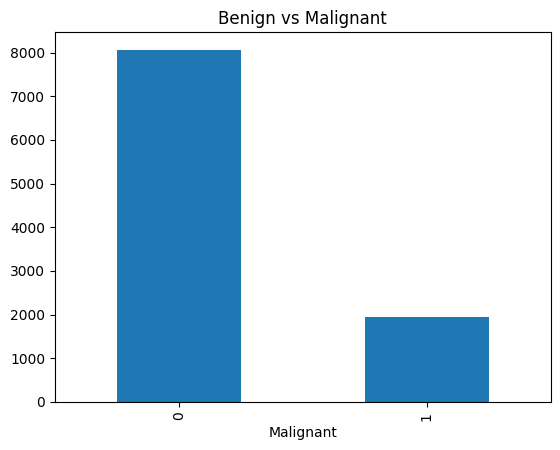

In [ ]:
skin_df["Malignant"].value_counts().plot(kind="bar", title="Benign vs Malignant")

<Axes: title={'center': 'Counts for each type of Lesions'}, xlabel='cell_type'>

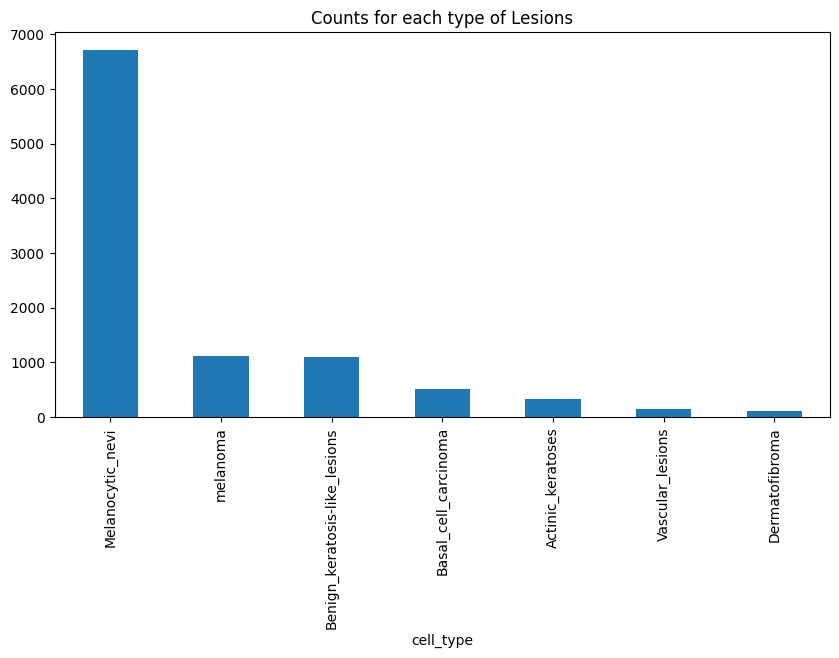

In [ ]:
fig, ax1 = plt.subplots(1,1,figsize=(10,5))
skin_df["cell_type"].value_counts().plot(kind="bar", ax=ax1, title="Counts for each type of Lesions") # plot a graph counting the number of each cell type

<Axes: title={'center': 'Location of Lesions'}, xlabel='localization'>

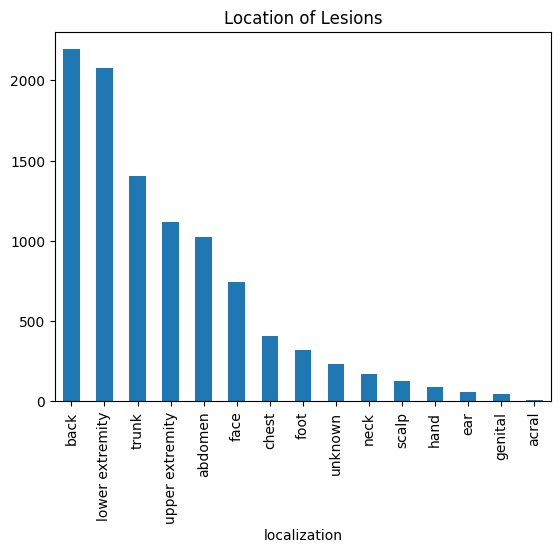

In [ ]:
# let's see where lesions are mostly located
skin_df["localization"].value_counts().plot(kind='bar', title="Location of Lesions")

<Axes: title={'center': 'Treatment received'}, xlabel='dx_type'>

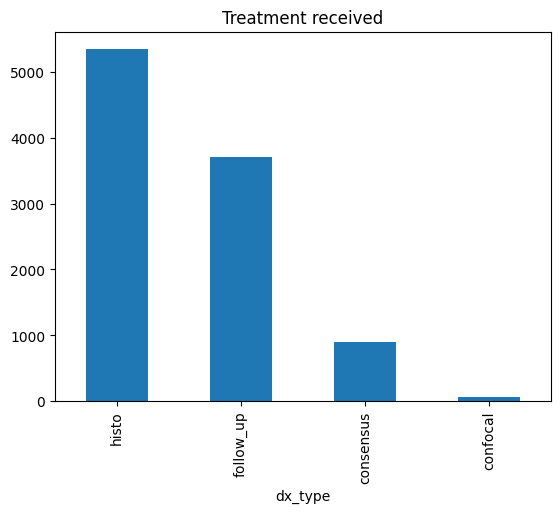

In [ ]:
skin_df["dx_type"].value_counts().plot(kind='bar', title="Treatment received")

<Axes: >

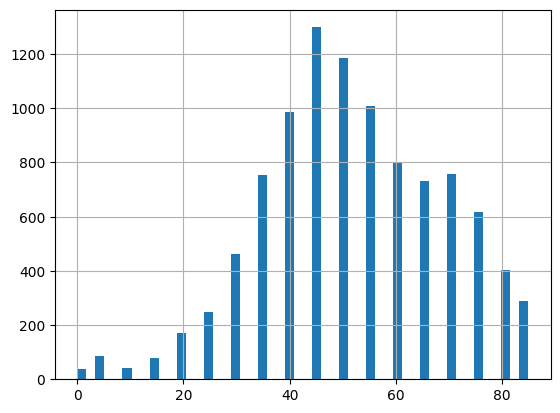

In [ ]:
skin_df["age"].hist(bins=50)

<Axes: >

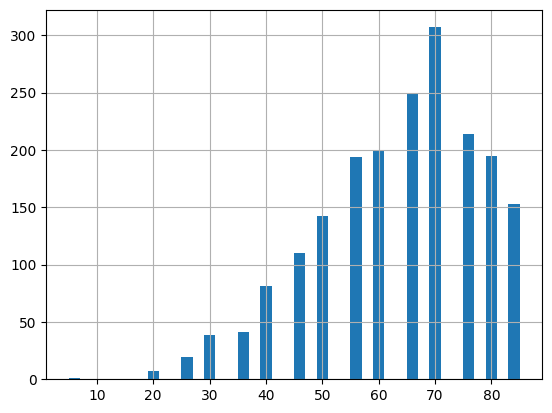

In [ ]:
skin_df[skin_df["Malignant"] == 1]["age"].hist(bins=40)

<Axes: title={'center': 'Male vs Female'}, xlabel='sex'>

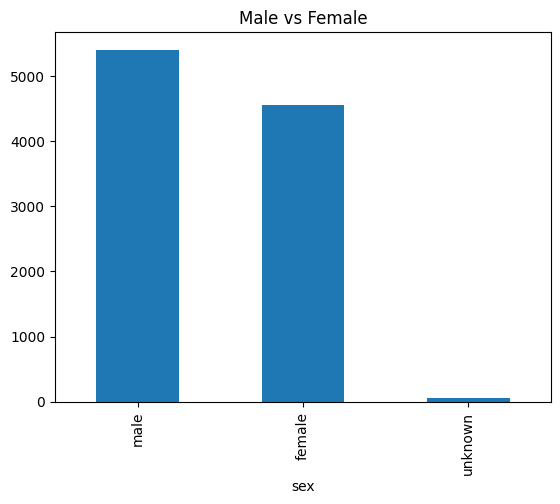

In [ ]:
skin_df["sex"].value_counts().plot(kind="bar", title="Male vs Female")

<Axes: title={'center': 'Male vs Female. Malignant Cases'}, xlabel='sex'>

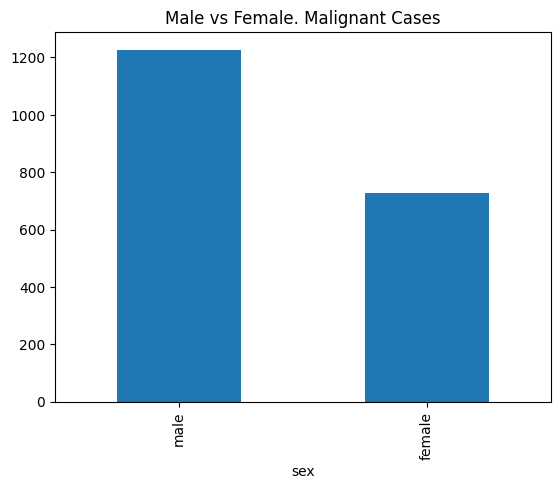

In [ ]:
skin_df[skin_df["Malignant"] == 1]["sex"].value_counts().plot(kind="bar", title="Male vs Female. Malignant Cases")

In [ ]:
from skimage.io import imread

In [ ]:
# skin_df = skin_df[skin_df["path"]]

In [ ]:
skin_df["image"] = skin_df["path"].map(imread) # read the image to array values

array([[[188, 147, 191],
        [186, 148, 189],
        [187, 150, 191],
        ...,
        [196, 155, 171],
        [197, 156, 170],
        [197, 157, 168]],

       [[186, 149, 193],
        [187, 152, 194],
        [189, 153, 191],
        ...,
        [194, 156, 169],
        [195, 159, 169],
        [192, 159, 168]],

       [[185, 148, 192],
        [189, 152, 195],
        [190, 153, 196],
        ...,
        [196, 155, 169],
        [198, 157, 171],
        [194, 156, 169]],

       ...,

       [[157, 124, 155],
        [156, 121, 154],
        [159, 124, 154],
        ...,
        [177, 146, 161],
        [176, 144, 159],
        [175, 141, 155]],

       [[155, 122, 151],
        [156, 123, 154],
        [156, 123, 152],
        ...,
        [178, 147, 163],
        [175, 144, 159],
        [175, 142, 159]],

       [[154, 119, 151],
        [153, 120, 149],
        [154, 121, 152],
        ...,
        [176, 147, 167],
        [175, 147, 161],
        [173, 143, 155]]], dtype=uint8)
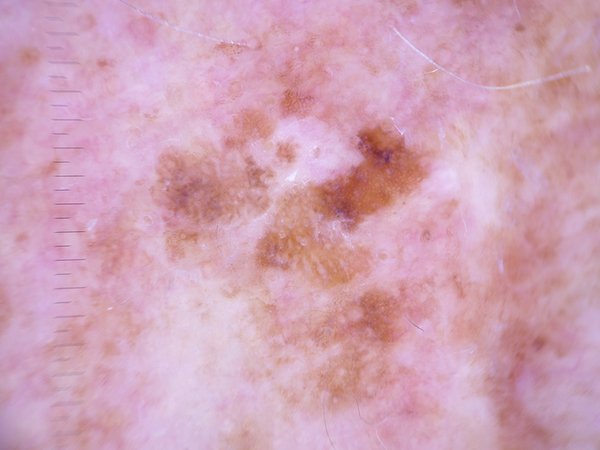

In [ ]:
skin_df.iloc[0]["image"] # here is a sample

In [ ]:
# let's see what is the shape of each value in the image column
skin_df["image"].map(lambda x: x.shape).value_counts()

,count
image,
"(450, 600, 3)",10015


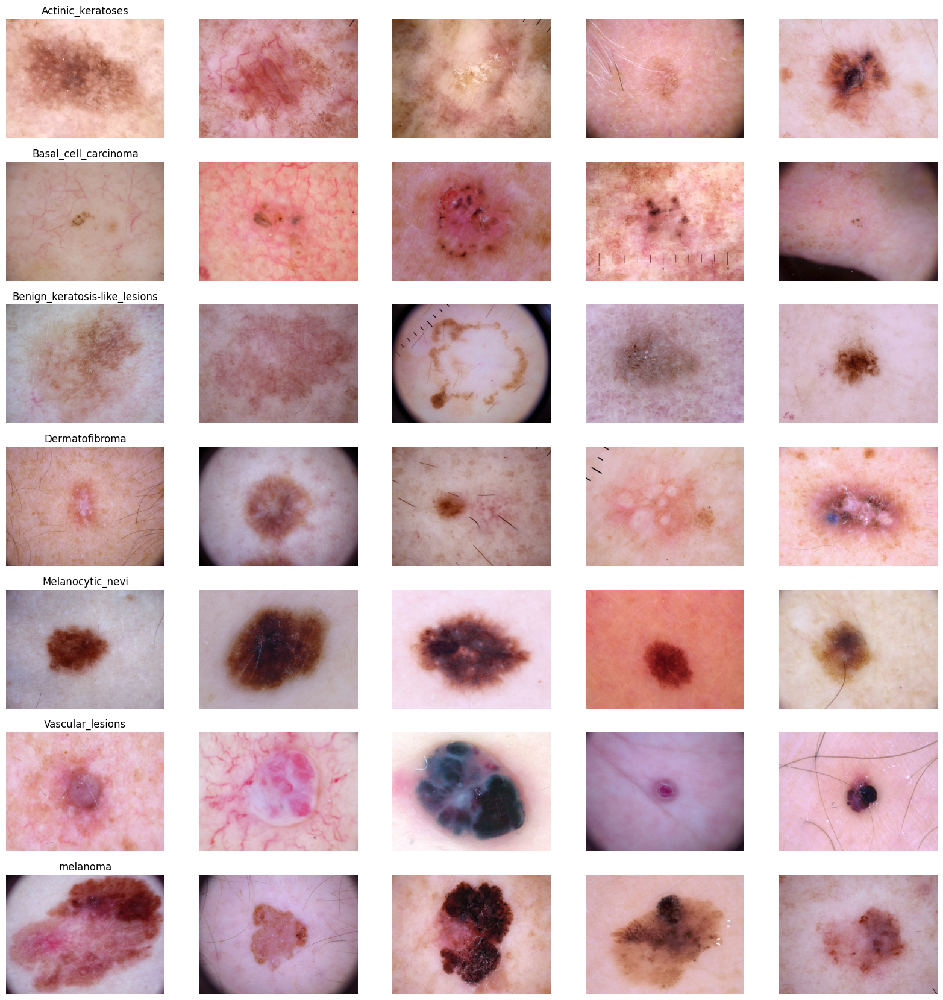

In [ ]:
# let's have a look at the image data

n_samples = 5 # choose 5 samples for each cell type
fig, m_axs = plt.subplots(7, n_samples, figsize=(4*n_samples, 3 * 7))

for n_axs, (type_name, type_rows) in zip(m_axs, skin_df.sort_values(["cell_type"]).groupby("cell_type")):
    n_axs[0].set_title(type_name)
    for c_ax, (_, c_row) in zip(n_axs, type_rows.sample(n_samples, random_state=0).iterrows()):
        c_ax.imshow(c_row["image"])
        c_ax.axis("off")
# fig.savefig("category_samples.png", dpi=300)

In [ ]:
# create a pandas dataframe to store mean value of Red, Blue and Green for each picture
rgb_info_df = skin_df.apply(lambda x: pd.Series({'{}_mean'.format(k): v for k, v
                                                 in zip(["Red", "Blue", "Green"],
                                                        np.mean(x["image"], (0, 1)))}), 1)


gray_col_vec = rgb_info_df.apply(lambda x: np.mean(x), 1) # take the mean value across columns of rgb_info_df
for c_col in rgb_info_df.columns:
    rgb_info_df[c_col] = rgb_info_df[c_col]/gray_col_vec
rgb_info_df["Gray_mean"] = gray_col_vec
rgb_info_df.sample(3)

,Red_mean,Blue_mean,Green_mean,Gray_mean
8864,1.092929,0.930124,0.976947,137.507783
389,1.102955,0.893952,1.003093,143.993065
1405,1.096534,0.904010,0.999456,155.548840


In [ ]:
for c_col in rgb_info_df.columns:
    skin_df[c_col] = rgb_info_df[c_col].values

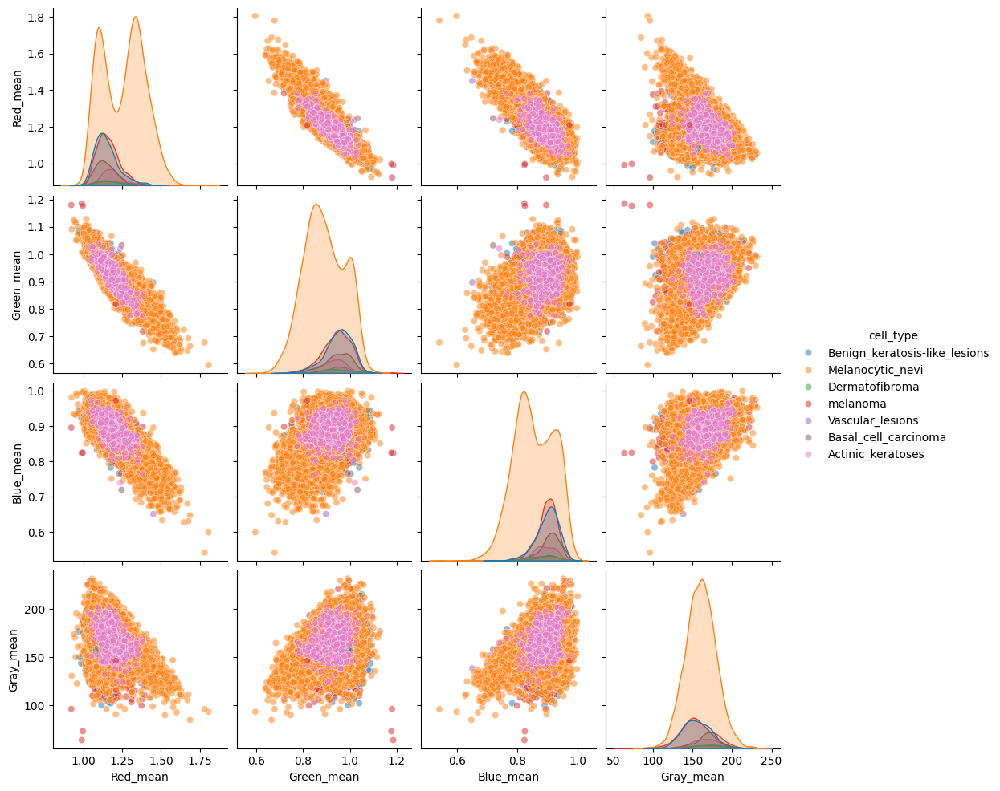

In [ ]:
# let's draw a plot showing the distribution of different cell types over colors!
sns.pairplot(skin_df[["Red_mean", "Green_mean", "Blue_mean", "Gray_mean", "cell_type"]],
             hue="cell_type", plot_kws = {"alpha": 0.5})

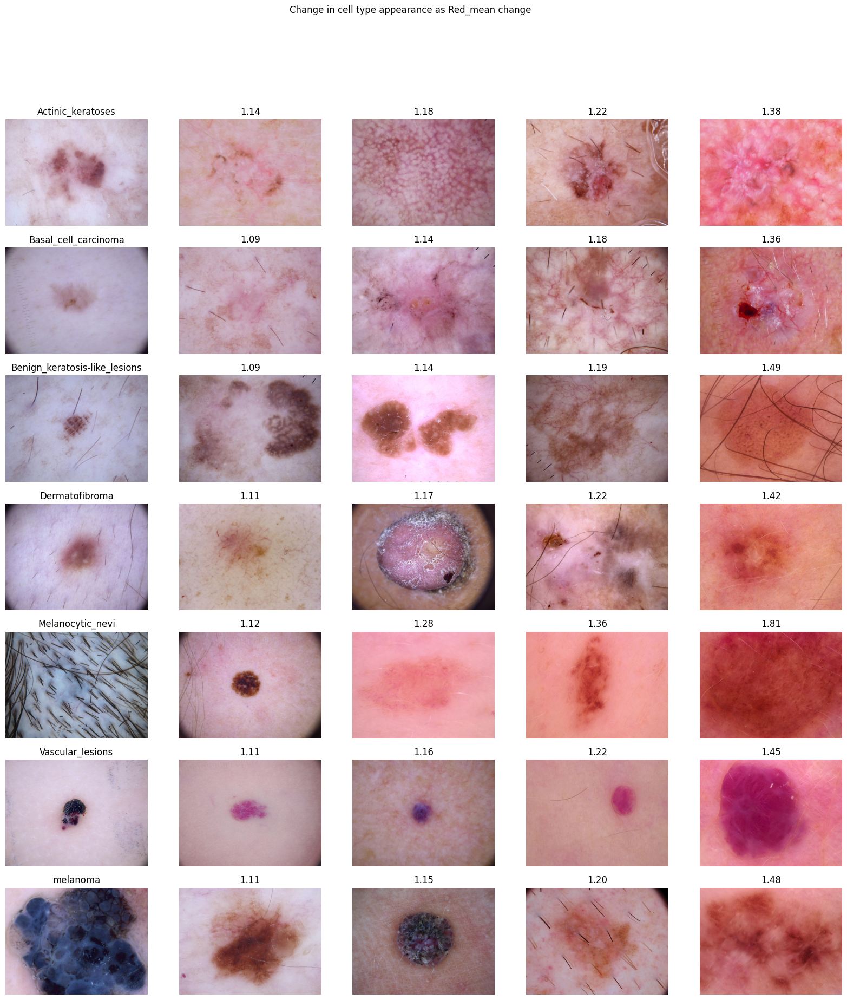

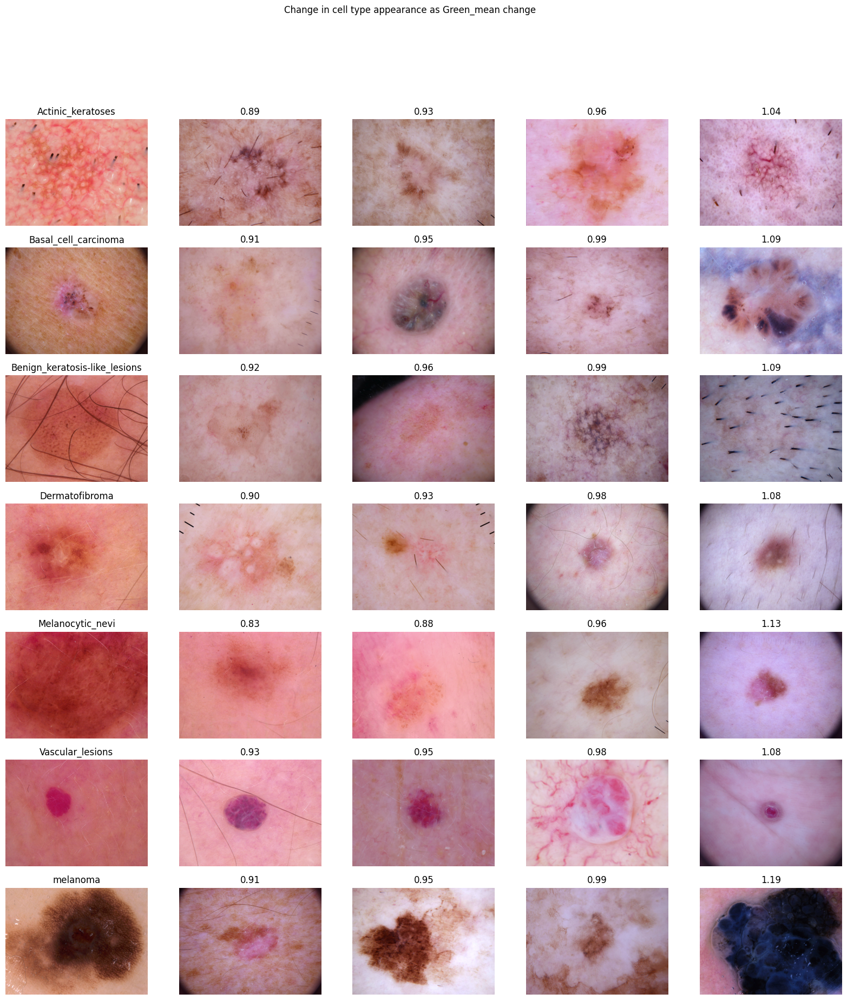

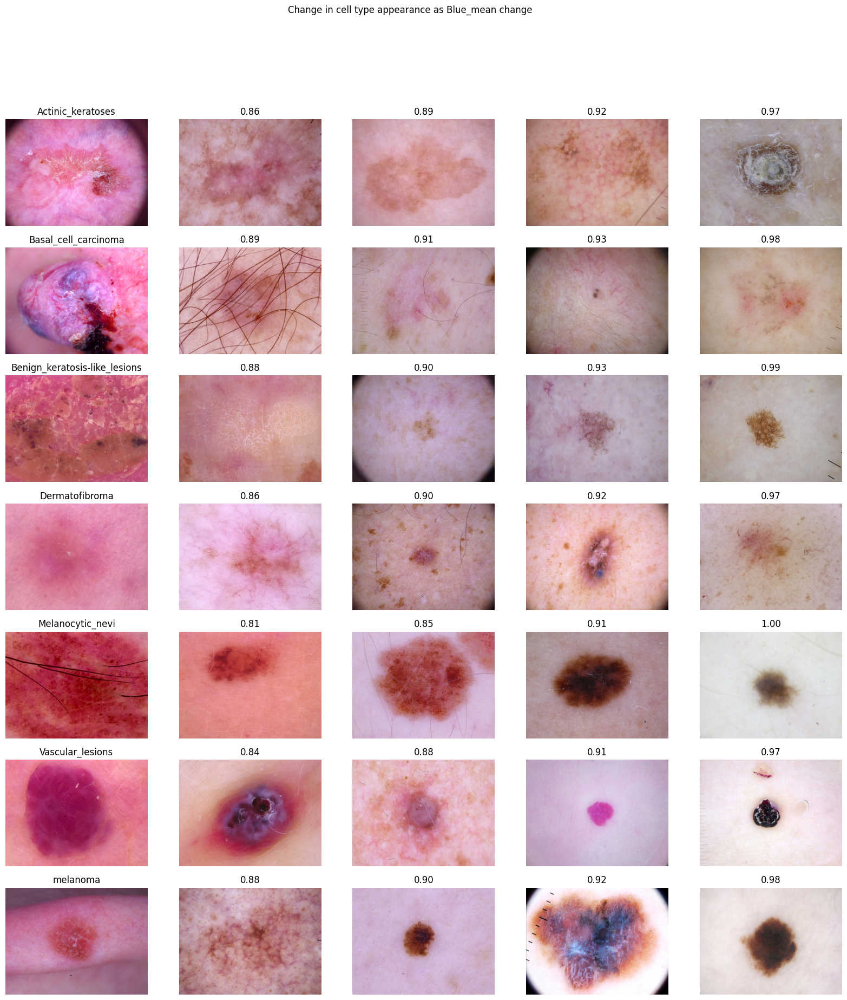

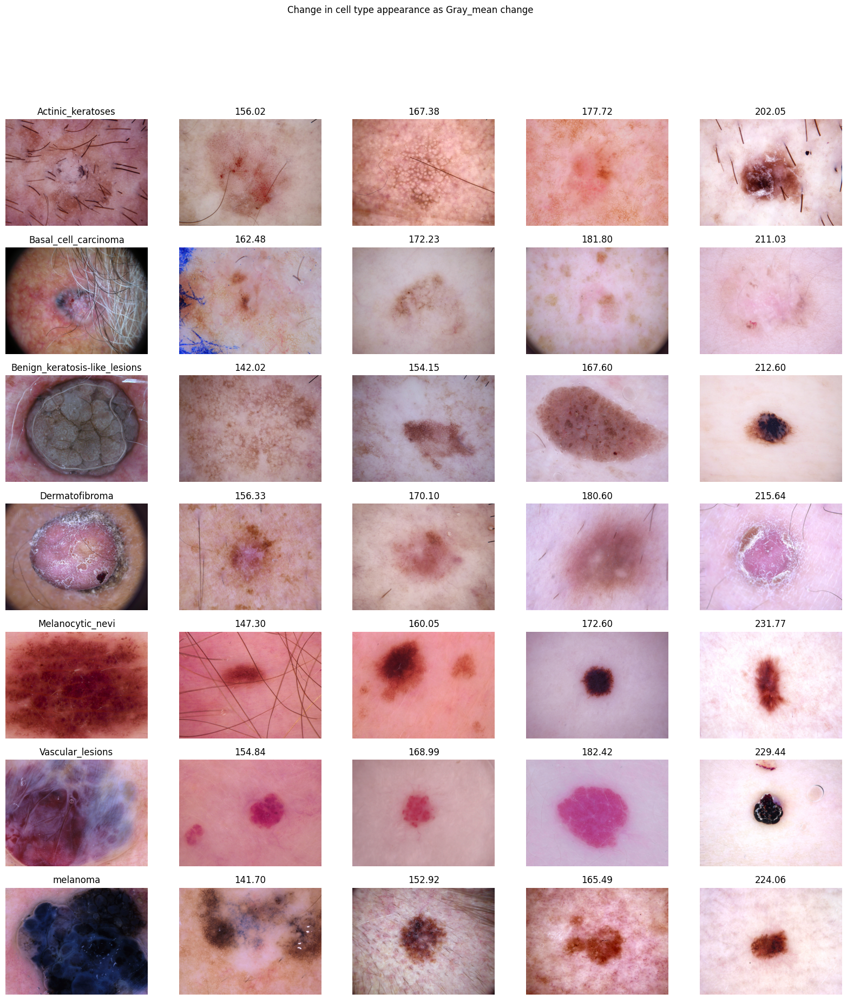

In [ ]:
n_samples = 5
for sample_col in ["Red_mean", "Green_mean", "Blue_mean", "Gray_mean"]:
    fig, m_axs = plt.subplots(7, n_samples, figsize=(4 * n_samples, 3 * 7))
    fig.suptitle(f"Change in cell type appearance as {sample_col} change")
    # define a function to get back a dataframe with 5 samples sorted by color channel values
    def take_n_space(in_rows, val_col, n):
        s_rows = in_rows.sort_values([val_col])
        s_idx = np.linspace(0, s_rows.shape[0] - 1, n, dtype=int)
        return s_rows.iloc[s_idx]

    for n_axs, (type_name, type_rows) in zip(m_axs, skin_df.sort_values(["cell_type"]).groupby("cell_type")):
        for c_ax, (_, c_row) in zip(n_axs, take_n_space(type_rows, sample_col, n_samples).iterrows()):
            c_ax.imshow(c_row["image"])
            c_ax.axis("off")
            c_ax.set_title('{:2.2f}'.format(c_row[sample_col]))
        n_axs[0].set_title(type_name)
    fig.savefig("{}_samples.png".format(sample_col), dpi=300)

In [ ]:
from PIL import Image

In [ ]:
reshaped_image = skin_df["path"].map(lambda x: np.asarray(Image.open(x).resize((64,64), resample=Image.LANCZOS).\
                                                          convert("RGB")).ravel())

In [ ]:
out_vec = np.stack(reshaped_image, 0)

In [ ]:
out_df = pd.DataFrame(out_vec)

In [ ]:
out_df

,0,1,2,3,4,5,6,7,8,9,...,12278,12279,12280,12281,12282,12283,12284,12285,12286,12287
0,191,152,194,191,153,195,192,149,192,194,...,164,185,154,180,186,156,184,182,152,173
1,24,13,23,24,14,28,37,24,46,61,...,30,26,15,29,27,15,28,24,13,25
2,185,129,140,192,136,151,198,142,156,198,...,139,152,120,138,144,113,123,115,81,84
3,24,11,19,36,19,30,64,38,50,91,...,17,27,13,16,25,12,16,24,9,14
4,138,94,117,158,113,138,178,133,161,191,...,140,140,106,118,108,77,92,67,40,55
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10010,161,142,154,159,142,153,153,136,147,151,...,184,208,187,187,205,185,186,201,183,184
10011,6,6,4,7,8,6,8,8,6,28,...,7,8,8,6,6,7,5,3,4,2
10012,116,107,109,141,128,128,133,117,113,156,...,156,162,137,132,174,153,148,172,152,146
10013,159,123,145,156,115,133,161,130,150,165,...,166,187,160,171,183,159,166,182,153,163


In [ ]:
out_df["label"] = skin_df["Malignant"].values

In [ ]:
out_df

,0,1,2,3,4,5,6,7,8,9,...,12279,12280,12281,12282,12283,12284,12285,12286,12287,label
0,191,152,194,191,153,195,192,149,192,194,...,185,154,180,186,156,184,182,152,173,0
1,24,13,23,24,14,28,37,24,46,61,...,26,15,29,27,15,28,24,13,25,0
2,185,129,140,192,136,151,198,142,156,198,...,152,120,138,144,113,123,115,81,84,0
3,24,11,19,36,19,30,64,38,50,91,...,27,13,16,25,12,16,24,9,14,0
4,138,94,117,158,113,138,178,133,161,191,...,140,106,118,108,77,92,67,40,55,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10010,161,142,154,159,142,153,153,136,147,151,...,208,187,187,205,185,186,201,183,184,1
10011,6,6,4,7,8,6,8,8,6,28,...,8,8,6,6,7,5,3,4,2,1
10012,116,107,109,141,128,128,133,117,113,156,...,162,137,132,174,153,148,172,152,146,1
10013,159,123,145,156,115,133,161,130,150,165,...,187,160,171,183,159,166,182,153,163,1


In [ ]:
out_path = "hmnist_64_64_RBG.csv"
out_df.to_csv(out_path, index=False)

In [ ]:
out_df

,0,1,2,3,4,5,6,7,8,9,...,12279,12280,12281,12282,12283,12284,12285,12286,12287,label
0,191,152,194,191,153,195,192,149,192,194,...,185,154,180,186,156,184,182,152,173,0
1,24,13,23,24,14,28,37,24,46,61,...,26,15,29,27,15,28,24,13,25,0
2,185,129,140,192,136,151,198,142,156,198,...,152,120,138,144,113,123,115,81,84,0
3,24,11,19,36,19,30,64,38,50,91,...,27,13,16,25,12,16,24,9,14,0
4,138,94,117,158,113,138,178,133,161,191,...,140,106,118,108,77,92,67,40,55,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10010,161,142,154,159,142,153,153,136,147,151,...,208,187,187,205,185,186,201,183,184,1
10011,6,6,4,7,8,6,8,8,6,28,...,8,8,6,6,7,5,3,4,2,1
10012,116,107,109,141,128,128,133,117,113,156,...,162,137,132,174,153,148,172,152,146,1
10013,159,123,145,156,115,133,161,130,150,165,...,187,160,171,183,159,166,182,153,163,1


In [ ]:
# datatest=pd.merge(skin_df, out_df, on = "row_num", how = "right")
# Rename the 'Unnamed: 0' column to 'row_num' in out_df
out_df = out_df.rename(columns={'Unnamed: 0': 'row_num'})

# Reset index of skin_df to create a 'row_num' column
skin_df = skin_df.reset_index().rename(columns={'index': 'row_num'})

# Now merge the DataFrames using the 'row_num' column
datatest = pd.concat([skin_df, out_df],axis=1)

# Save the merged DataFrame to a CSV file
# datatest.to_csv("all_hmnist_64_64_RBG.csv", index=False)  # Set index=False to avoid saving the index again
# datatest.to_csv("all_hmnist_64_64_RBG.csv")

In [ ]:
datatest.drop(columns=["row_num"])
datatest.to_csv("all_hmnist_64_64_RBG.csv", index=False)

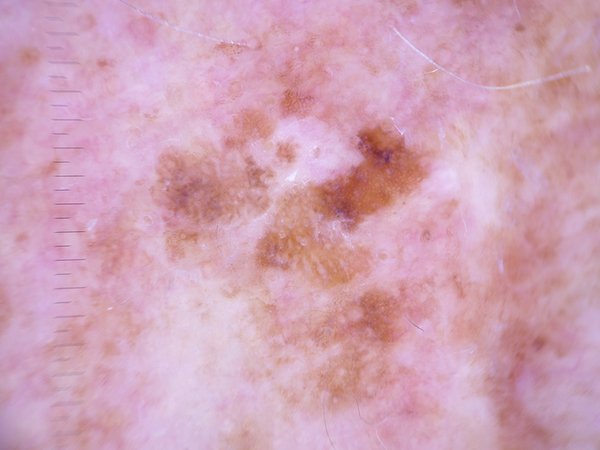

In [ ]:
img = Image.open(skin_df["path"].iloc[0])
img

In [ ]:
!mkdir skin_lesion_types

In [ ]:
skin_df["cell_type"].unique()

array(['Benign_keratosis-like_lesions', 'Melanocytic_nevi',
       'Dermatofibroma', 'melanoma', 'Vascular_lesions',
       'Basal_cell_carcinoma', 'Actinic_keratoses'], dtype=object)

In [ ]:
skin_df["path"].iloc[0]

'/content/drive/MyDrive/final_yr_project/img_dataset/ISIC_0027419.jpg'

In [ ]:
# for index in skin_df.index.values.tolist():
for index in range(len(skin_df)):
    path = skin_df["path"].iloc[index]
    cell_type_idx = skin_df["cell_type"].iloc[index]
    img_id = skin_df["image_id"].iloc[index]
    newpath = f"/content/skin_lesion_types/{cell_type_idx}/{img_id}.jpg"
    directory = os.path.dirname(newpath)
    if not os.path.exists(directory):
        os.makedirs(directory)  # Create the directory (and intermediate ones)

    try:
        # Open the source image
        img = Image.open(path)

        # Resize the image
        img = img.resize((299, 299), resample=Image.LANCZOS)

        # Save the image to the new path
        img.save(newpath)
        # print(f"Image saved to {newpath}")
    except FileNotFoundError:
        print(f"File not found: {path}")
    except Exception as e:
        print(f"Error processing image at index {index}: {e}")
    # img = Image.open(path)
    # img = img.resize((299, 299), resample=Image.LANCZOS)
    # img.save(newpath)

In [ ]:
# reshaped_image = skin_df["path"].map(lambda x: np.asarray(Image.open(x).resize((256,192), resample=Image.LANCZOS).\
                                                          # convert("RGB")))

In [ ]:
# out_vec = np.stack(reshaped_image, 0)

In [ ]:
# out_vec.shape

In [ ]:
# out_vec = out_vec.astype("float32")
# out_vec /= 255

In [ ]:
labels = skin_df["Malignant"].values

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train_orig, X_test, y_train_orig, y_test = train_test_split(out_vec, labels, test_size=0.1,random_state=0)

In [ ]:
np.save("256_192_test.npy", X_test)
np.save("test_labels.npy", y_test)

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X_train_orig, y_train_orig, test_size=0.1, random_state=1)

In [ ]:
np.save("256_192_val.npy", X_val)
np.save("val_labels.npy", y_val)

In [ ]:
np.save("256_192_train.npy", X_train)
np.save("train_labels.npy", y_train)